# Повторение примеров

## Решение обыкновенных дифференциальных уравне

### Модель экспоненциального роста

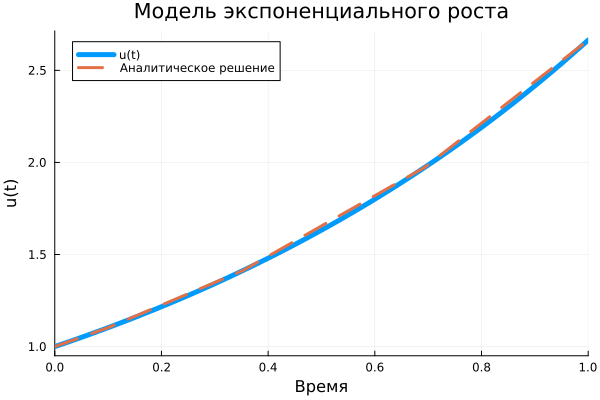

In [1]:
using DifferentialEquations
# задаём описание модели с начальными условиями:
a = 0.98
f(u,p,t) = a*u
u0 = 1.0
# задаём интервал времени:
tspan = (0.0,1.0)
# решение:
prob = ODEProblem(f,u0,tspan)
sol = solve(prob)
# подключаем необходимые пакеты:
using Plots
# строим графики:
plot(sol, linewidth=5,title="Модель экспоненциального роста", xaxis="Время",yaxis="u(t)",label="u(t)")
plot!(sol.t, t->1.0*exp(a*t),lw=3,ls=:dash,label="Аналитическое решение")

ODESolution{Float64, 1, Vector{Float64}, Nothing, Nothing, Vector{Float64}, Vector{Vector{Float64}}, ODEProblem{Float64, Tuple{Float64, Float64}, false, SciMLBase.NullParameters, ODEFunction{false, SciMLBase.AutoSpecialize, typeof(f), LinearAlgebra.UniformScaling{Bool}, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, Nothing, typeof(SciMLBase.DEFAULT_OBSERVED), Nothing, Nothing}, Base.Pairs{Symbol, Union{}, Tuple{}, NamedTuple{(), Tuple{}}}, SciMLBase.StandardODEProblem}, CompositeAlgorithm{Tuple{Vern7{typeof(OrdinaryDiffEq.trivial_limiter!), typeof(OrdinaryDiffEq.trivial_limiter!), Static.False}, Rodas5P{0, false, Nothing, typeof(OrdinaryDiffEq.DEFAULT_PRECS), Val{:forward}, true, nothing}}, OrdinaryDiffEq.AutoSwitchCache{Vern7{typeof(OrdinaryDiffEq.trivial_limiter!), typeof(OrdinaryDiffEq.trivial_limiter!), Static.False}, Rodas5P{0, false, Nothing, typeof(OrdinaryDiffEq.DEFAULT_PRECS), Val{:forward}, true, nothing},

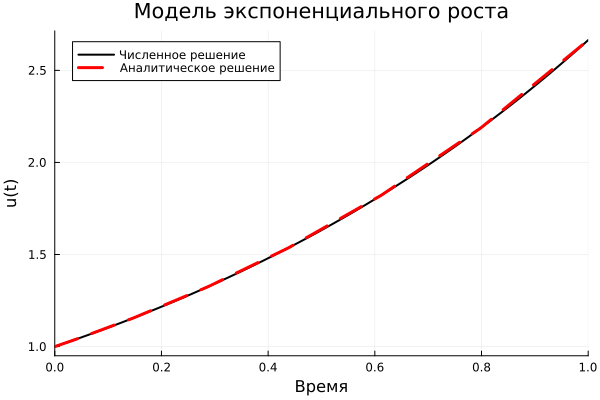

In [2]:
# задаём точность решения:
sol = solve(prob,abstol=1e-8,reltol=1e-8)
println(sol)
# строим график:
plot(sol, lw=2, color="black", title="Модель экспоненциального роста", xaxis="Время",yaxis="u(t)",label="Численное решение")
plot!(sol.t, t->1.0*exp(a*t),lw=3,ls=:dash,color="red",label="Аналитическое решение")

### Система Лоренца

┌ Warning: To maintain consistency with solution indexing, keyword argument vars will be removed in a future version. Please use keyword argument idxs instead.
│   caller = ip:0x0
└ @ Core :-1


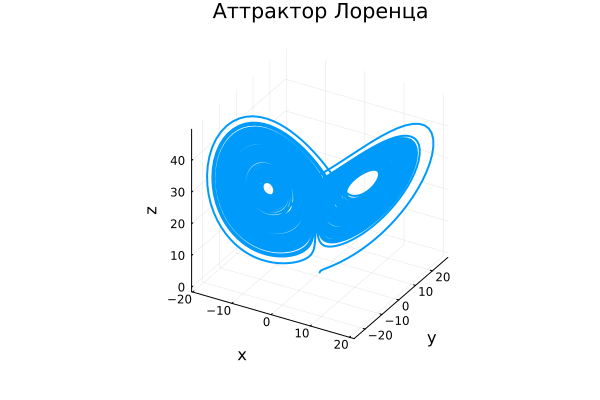

In [3]:
# задаём описание модели:
function lorenz!(du,u,p,t)
σ,ρ,β = p
    du[1] = σ*(u[2]-u[1])
    du[2] = u[1]*(ρ-u[3]) - u[2]
du[3] = u[1]*u[2] - β*u[3]
end
# задаём начальное условие:
u0 = [1.0,0.0,0.0]
# задаём знанчения параметров:
p = (10,28,8/3)
# задаём интервал времени:
tspan = (0.0,100.0)
# решение:
prob = ODEProblem(lorenz!,u0,tspan,p)
sol = solve(prob)
# строим график:
plot(sol, vars=(1,2,3), lw=2, title="Аттрактор Лоренца", xaxis="x",yaxis="y", zaxis="z",legend=false)

Без интерполяции

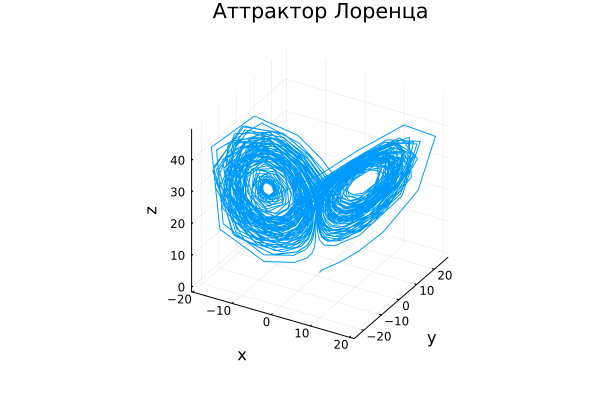

In [4]:
# отключаем интерполяцию:
plot(sol,vars=(1,2,3),denseplot=false, lw=1, title="Аттрактор Лоренца", xaxis="x",yaxis="y", zaxis="z",legend=false)

## Модель Лотки–Вольтерры

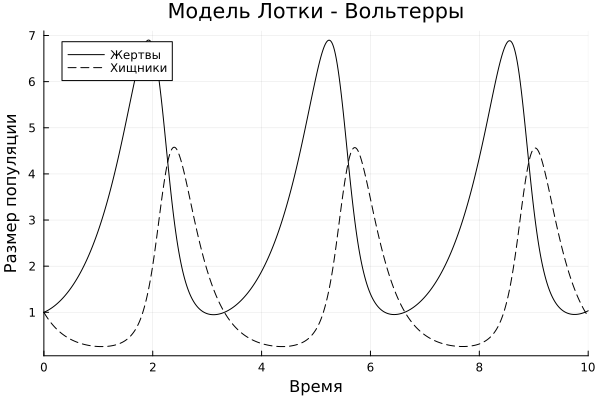

In [5]:
using ParameterizedFunctions, DifferentialEquations, Plots;
# задаём описание модели:
lv! = @ode_def LotkaVolterra begin
dx = a*x - b*x*y
dy = -c*y + d*x*y
end a b c d
# задаём начальное условие:
u0 = [1.0,1.0]
# задаём знанчения параметров:
p = (1.5,1.0,3.0,1.0)
# задаём интервал времени:
tspan = (0.0,10.0)
# решение:
prob = ODEProblem(lv!,u0,tspan,p)
sol = solve(prob)
plot(sol, label = ["Жертвы" "Хищники"], color="black", ls=[:solid :dash], title="Модель Лотки - Вольтерры", xaxis="Время",yaxis="Размер популяции")

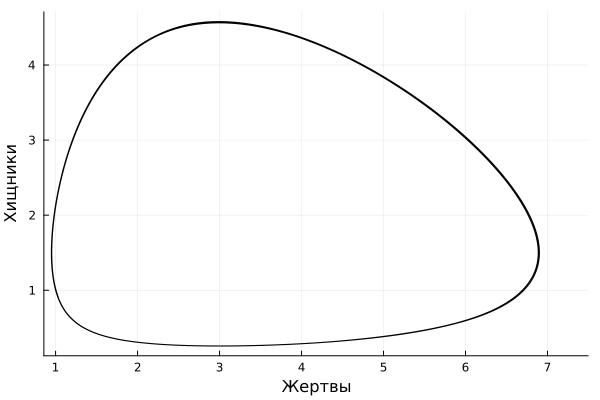

In [6]:
# фазовый портрет:
plot(sol,vars=(1,2), color="black", xaxis="Жертвы",yaxis="Хищники", legend=false)

# Самостоятельная работа

## Модель Мальтуса

Модель Мальтуса --- модель роста численности изолированной популяции, где изменение роста популяции контролируется численностью уже существующей популяции, домноженной на коэффициент $a$, который является разницей между рождаемостью и смертностью ($b-c$). Коэффициенты $b$ и $c$ было предложено выбрать самостоятельно, и я выставлю для системы значения $b=1.09$ и $c=1.134$ (что является соответственно коэффициентами рождаемости и смертности за январь-август в 2022 году в Центральном федеральном округе РФ). Изначальная численность населения ($39 433 556$ человек) также взята из статистики Росстата за 2022 год (с учётом переписи населения).

Модель Мальтуса подразумевает, что коэффициенты рождаемости и смертности не изменяются, так что если $b$ превышает $c$, численность популяции будет расти (и наоборот).

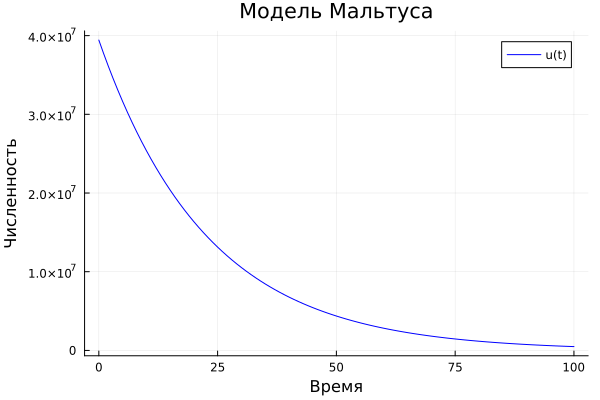

In [7]:
function Maltus!(du,u,p,t)
    du[1] = (p[1]-p[2])*u[1]
end
u0 = [39433556.0]
tspan = (0.0,100.0)
p = Float64[1.09, 1.134]
prob = ODEProblem(Maltus!,u0,tspan,p)
sol = solve(prob,abstol=1e-6,reltol=1e-6, saveat=1.0)
R1 = [tu[1] for tu in sol.u]
plot(sol.t, R1, title="Модель Мальтуса", xaxis="Время",yaxis="Численность",label="u(t)", c=:blue)

[ Info: Saved animation to D:\Education\КомпПрактикумПоСтатМоделированию\labs\gitrepo\lab6\presentation\image\1.gif


Plots.AnimatedGif("D:\\Education\\КомпПрактикумПоСтатМоделированию\\labs\\gitrepo\\lab6\\presentation\\image\\1.gif")
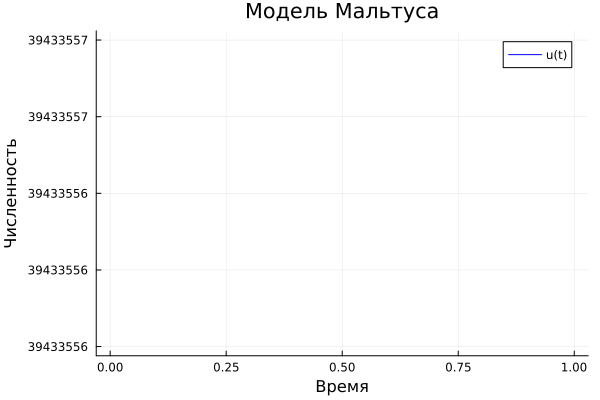

In [8]:
anim = @animate for i in 1:length(sol.t)
    plot(sol.t[1:i], R1[1:i], title="Модель Мальтуса", xaxis="Время",yaxis="Численность",label="u(t)", c=:blue)
end
gif(anim, "presentation//image//1.gif")

## Логистическая модель роста популяции

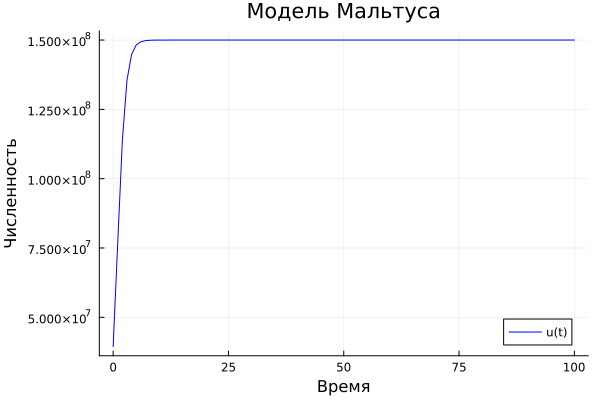

In [9]:
function LogModPop!(du,u,p,t)
    du[1] = p[1]*u[1]*(1-u[1]/p[2])
end
u0 = [39433556.0]
tspan = (0.0,100.0)
p = Float64[1.09, 15e7]
prob = ODEProblem(LogModPop!,u0,tspan,p)
sol = solve(prob,abstol=1e-6,reltol=1e-6, saveat=1.0)
R1 = [tu[1] for tu in sol.u]
plot(sol.t, R1, title="Модель Мальтуса", xaxis="Время",yaxis="Численность",label="u(t)", c=:blue)

[ Info: Saved animation to D:\Education\КомпПрактикумПоСтатМоделированию\labs\gitrepo\lab6\presentation\image\2.gif


Plots.AnimatedGif("D:\\Education\\КомпПрактикумПоСтатМоделированию\\labs\\gitrepo\\lab6\\presentation\\image\\2.gif")
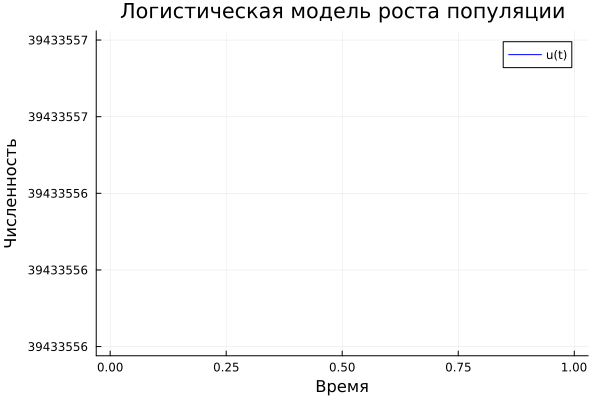

In [10]:
anim = @animate for i in 1:length(sol.t)
    plot(sol.t[1:i], R1[1:i], title="Логистическая модель роста популяции", xaxis="Время",yaxis="Численность",label="u(t)", c=:blue)
end
gif(anim, "presentation//image//2.gif")

## SIR

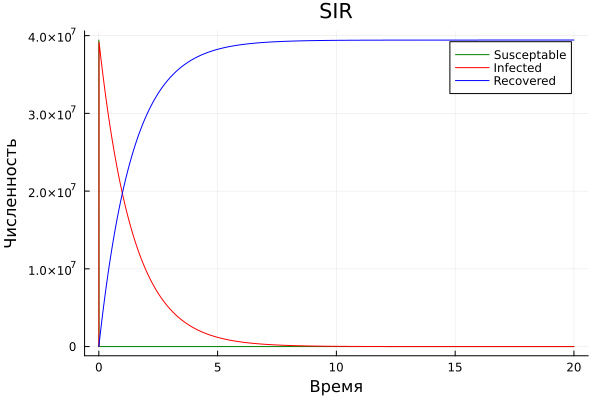

In [11]:
function SIR!(du,u,p,t)
    du[1] = -p[1]*u[1]*u[2] # S
    du[2] = p[1]*u[2]*u[1]-p[2]*u[2] # I
    du[3] = p[2]*u[2] # R
end
u0 = [39433553.0, 3.0, 0.0]
tspan = (0.0,20.0)
p = Float64[0.3,0.7]
prob = ODEProblem(SIR!,u0,tspan,p)
sol = solve(prob,abstol=1e-6,reltol=1e-6, saveat=0.01)
R1 = [tu[1] for tu in sol.u]
R2 = [tu[2] for tu in sol.u]
R3 = [tu[3] for tu in sol.u]
plot(sol.t, R1, title="SIR", xaxis="Время",yaxis="Численность",label="Susceptable", c=:green, leg=:topright)
plot!(sol.t, R2, title="SIR", label="Infected", c=:red, leg=:topright)
plot!(sol.t, R3, label="Recovered", c=:blue, leg=:topright)

[ Info: Saved animation to D:\Education\КомпПрактикумПоСтатМоделированию\labs\gitrepo\lab6\presentation\image\3.gif


Plots.AnimatedGif("D:\\Education\\КомпПрактикумПоСтатМоделированию\\labs\\gitrepo\\lab6\\presentation\\image\\3.gif")
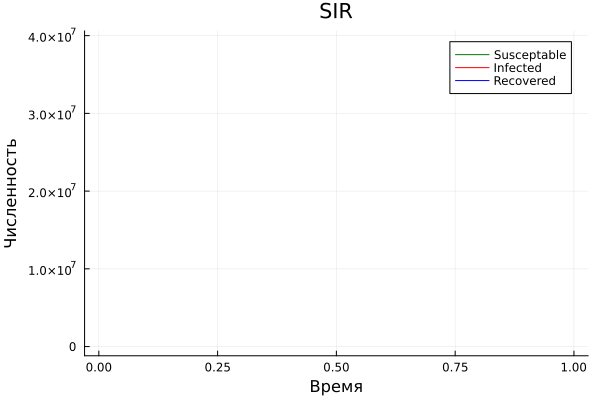

In [12]:
anim = @animate for i in 1:length(sol.t)
    plot(sol.t[1:i], R1[1:i], title="SIR", xaxis="Время",yaxis="Численность",label="Susceptable", c=:green, leg=:topright)
    plot!(sol.t[1:i], R2[1:i], title="SIR", label="Infected", c=:red, leg=:topright)
    plot!(sol.t[1:i], R3[1:i], label="Recovered", c=:blue, leg=:topright)
end
gif(anim, "presentation//image//3.gif")

## SEIR

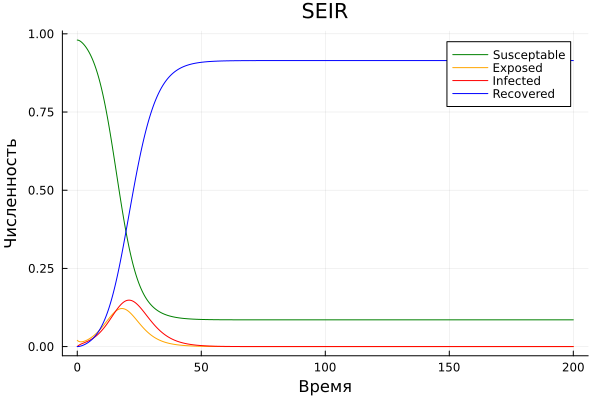

In [13]:
function SEIR!(du,u,p,t)
    betta, delta, gamma, N = p
    s, e, i, r = u
    du[1] = -betta / N * s * i
    du[2] = betta / N * s * i - delta * e
    du[3] = delta * e - gamma * i
    du[4] = gamma * i
end
u0 = [0.98, 0.02, 0.0, 0.0]
tspan = (0.0,200.0)
p = Float64[0.8,0.4,0.3,1.0]
prob = ODEProblem(SEIR!,u0,tspan,p)
sol = solve(prob,abstol=1e-6,reltol=1e-6, saveat=0.1)
R1 = [tu[1] for tu in sol.u]
R2 = [tu[2] for tu in sol.u]
R3 = [tu[3] for tu in sol.u]
R4 = [tu[4] for tu in sol.u]
plot(sol.t, R1, title="SEIR", xaxis="Время",yaxis="Численность",label="Susceptable", c=:green, leg=:topright)
plot!(sol.t, R2, label="Exposed", c=:orange, leg=:topright)
plot!(sol.t, R3, label="Infected", c=:red, leg=:topright)
plot!(sol.t, R4, label="Recovered", c=:blue, leg=:topright)

[ Info: Saved animation to D:\Education\КомпПрактикумПоСтатМоделированию\labs\gitrepo\lab6\presentation\image\4.gif


Plots.AnimatedGif("D:\\Education\\КомпПрактикумПоСтатМоделированию\\labs\\gitrepo\\lab6\\presentation\\image\\4.gif")
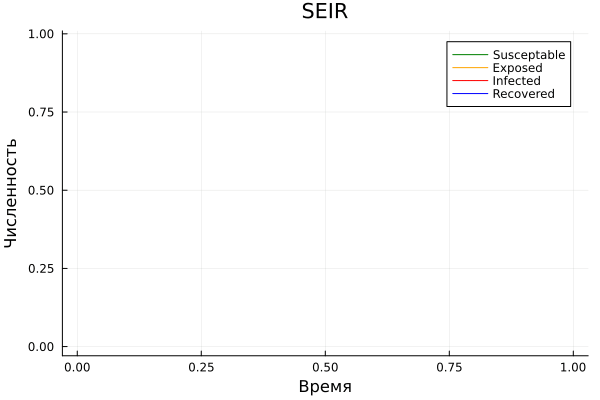

In [14]:
anim = @animate for i in 1:length(sol.t)
    plot(sol.t[1:i], R1[1:i], title="SEIR", xaxis="Время",yaxis="Численность",label="Susceptable", c=:green, leg=:topright)
    plot!(sol.t[1:i], R2[1:i], label="Exposed", c=:orange, leg=:topright)
    plot!(sol.t[1:i], R3[1:i], label="Infected", c=:red, leg=:topright)
    plot!(sol.t[1:i], R4[1:i], label="Recovered", c=:blue, leg=:topright)
end
gif(anim, "presentation//image//4.gif")

## Лотки-Вольтерры

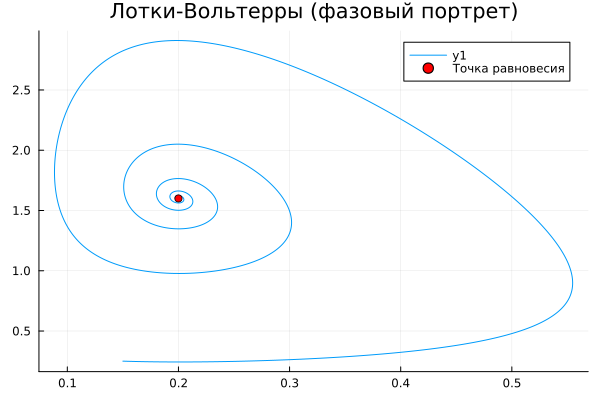

In [15]:
using NLsolve
# Аналитическое решение
function find_equilibrium(a, c, d)
    function system!(du, u)
        du[1] = a*u[1]*(1-u[1]) - u[1]*u[2]
        du[2] = -c*u[2] + d*u[1]*u[2]
    end

    initial_guess = [0.5, 0.5]
    result = nlsolve(system!, initial_guess)

    equilibrium_point = result.zero
    return equilibrium_point
end
# Численное решение
function LotkiVolterry(a, c, d, x1_0, x2_0, dt, num_steps)
    x1 = x1_0
    x2 = x2_0
    results = [(x1, x2)]

    for _ in 1:num_steps
        x1_new = x1 + dt * (a * x1 * (1 - x1) - x1 * x2)
        x2_new = x2 + dt * (-c * x2 + d * x1 * x2)
        x1, x2 = x1_new, x2_new
        push!(results, (x1, x2))
    end  
    
    return results
end

a = 2.0
c = 1.0
d = 5.0
x1_0 = 0.15
x2_0 = 0.25
dt = 0.01
num_steps = 10000

results = LotkiVolterry(a, c, d, x1_0, x2_0, dt, num_steps)
R1 = [x[1] for x in results]
R2 = [x[2] for x in results]

equilibrium = find_equilibrium(2,1,5)

plot(R1, R2, title="Лотки-Вольтерры (фазовый портрет)", leg=:topright)
scatter!([equilibrium[1]], [equilibrium[2]], color="red", label="Точка равновесия")

[ Info: Saved animation to D:\Education\КомпПрактикумПоСтатМоделированию\labs\gitrepo\lab6\presentation\image\5.gif


Plots.AnimatedGif("D:\\Education\\КомпПрактикумПоСтатМоделированию\\labs\\gitrepo\\lab6\\presentation\\image\\5.gif")
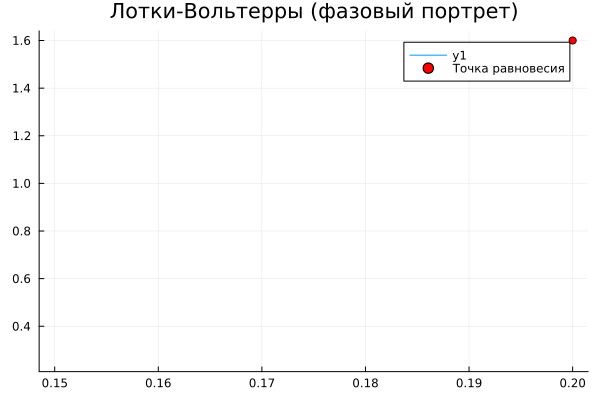

In [16]:
anim = @animate for i in 1:length(R1)
    plot(R1[1:i], R2[1:i], title="Лотки-Вольтерры (фазовый портрет)", leg=:topright)
    scatter!([equilibrium[1]], [equilibrium[2]], color="red", label="Точка равновесия")
end
gif(anim, "presentation//image//5.gif")

## Конкурентные отношения

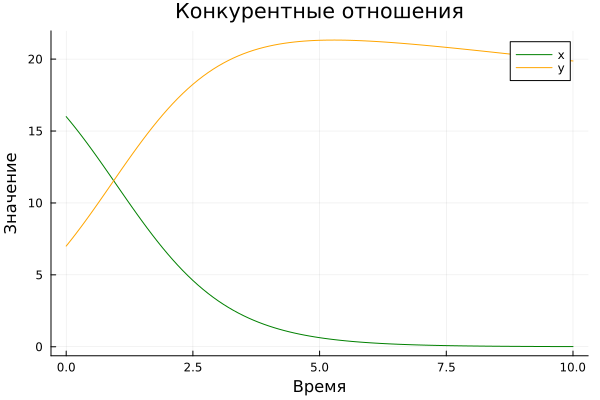

In [19]:
function KonkOtn!(du,u,p,t)
    du[1] = p[1] * u[1] - p[2] * u[1] * u[2]
    du[2] = -p[1] * u[2] + p[2] * u[1] * u[2]
end
u0 = [16.0,7.0]
tspan = (0.0,10.0)
p = Float64[0.02, 0.04]
prob = ODEProblem(KonkOtn!,u0,tspan,p)
sol = solve(prob,abstol=1e-6,reltol=1e-6, saveat=0.1)
R1 = [tu[1] for tu in sol.u]
R2 = [tu[2] for tu in sol.u]
plot(sol.t, R1, title="Конкурентные отношения", xaxis="Время",yaxis="Значение",label="x", c=:green, leg=:topright)
plot!(sol.t, R2, label="y", c=:orange, leg=:topright)

[ Info: Saved animation to D:\Education\КомпПрактикумПоСтатМоделированию\labs\gitrepo\lab6\presentation\image\6.gif


Plots.AnimatedGif("D:\\Education\\КомпПрактикумПоСтатМоделированию\\labs\\gitrepo\\lab6\\presentation\\image\\6.gif")
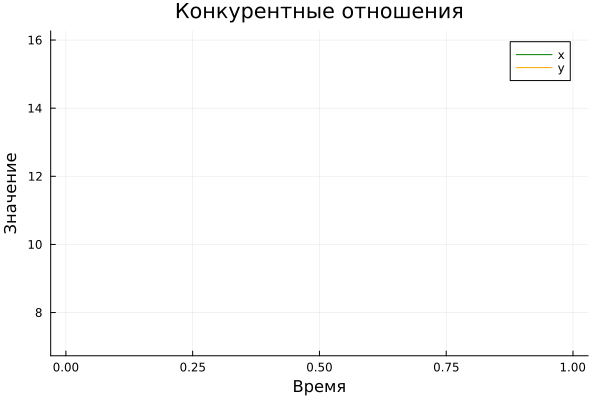

In [20]:
anim = @animate for i in 1:length(R1)
    plot(sol.t[1:i], R1[1:i], title="Конкурентные отношения", xaxis="Время",yaxis="Значение",label="x", c=:green, leg=:topright)
    plot!(sol.t[1:i], R2[1:i], label="y", c=:orange, leg=:topright)
end
gif(anim, "presentation//image//6.gif")

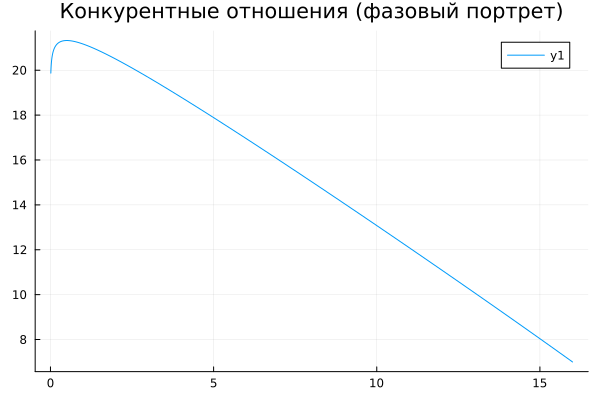

In [21]:
plot(R1, R2, title="Конкурентные отношения (фазовый портрет)", leg=:topright)

## Консервативный гармонический осциллятор

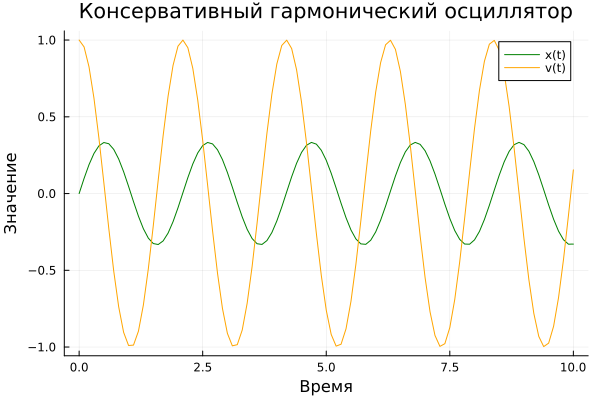

In [22]:
function KGO!(du,u,p,t)
    du[1] = u[2]
    du[2] = -p[1]^2 * u[1]
end
u0 = [0.0, 1.0]
tspan = (0.0,10.0)
p = Float64[3.0]
prob = ODEProblem(KGO!,u0,tspan,p)
sol = solve(prob,abstol=1e-6,reltol=1e-6, saveat=0.1)
R1 = [tu[1] for tu in sol.u]
R2 = [tu[2] for tu in sol.u]
plot(sol.t, R1, title="Консервативный гармонический осциллятор", xaxis="Время",yaxis="Значение",label="x(t)", c=:green, leg=:topright)
plot!(sol.t, R2, label="v(t)", c=:orange, leg=:topright)

[ Info: Saved animation to D:\Education\КомпПрактикумПоСтатМоделированию\labs\gitrepo\lab6\presentation\image\7.gif


Plots.AnimatedGif("D:\\Education\\КомпПрактикумПоСтатМоделированию\\labs\\gitrepo\\lab6\\presentation\\image\\7.gif")
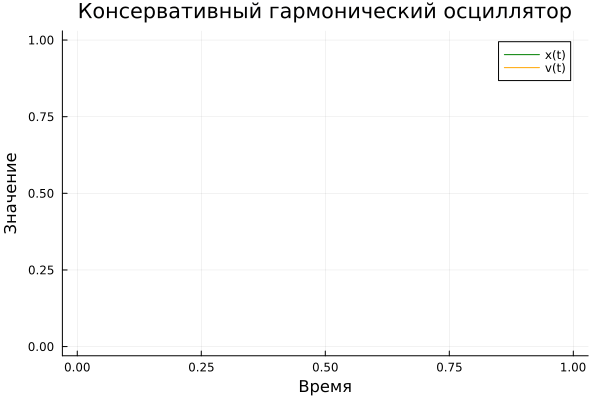

In [23]:
anim = @animate for i in 1:length(R1)
    plot(sol.t[1:i], R1[1:i], title="Консервативный гармонический осциллятор", xaxis="Время",yaxis="Значение",label="x(t)", c=:green, leg=:topright)
    plot!(sol.t[1:i], R2[1:i], label="v(t)", c=:orange, leg=:topright)
end
gif(anim, "presentation//image//7.gif")

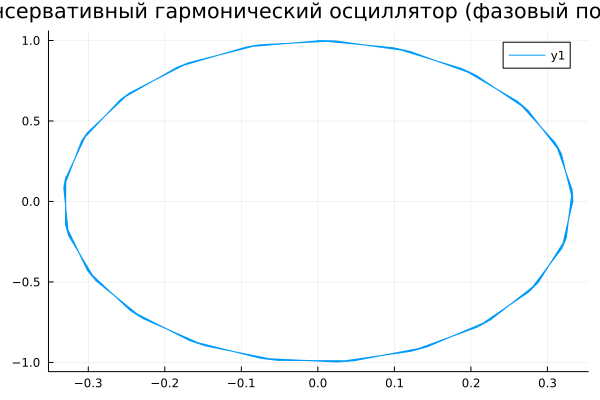

In [24]:
plot(R1, R2, title="Консервативный гармонический осциллятор (фазовый портрет)", leg=:topright)

## Гармонический осциллятор

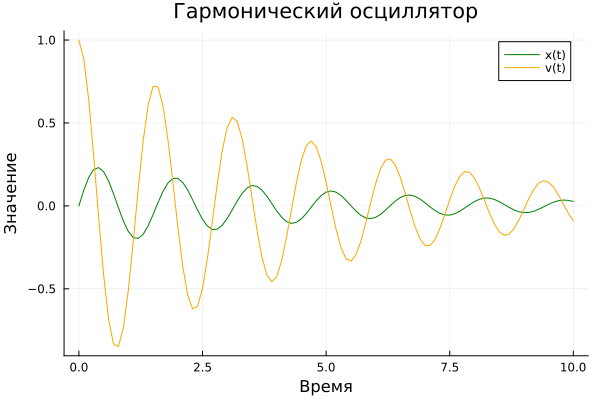

In [30]:
function GO!(du,u,p,t)
    du[1] = u[2]
    du[2] = -2.0*p[2]*u[2] - p[1]^2*u[1]
end
u0 = [0.0, 1.0]
tspan = (0.0,10.0)
p = Float64[4.0, 0.2]
prob = ODEProblem(GO!,u0,tspan,p)
sol = solve(prob,abstol=1e-6,reltol=1e-6, saveat=0.1)
R1 = [tu[1] for tu in sol.u]
R2 = [tu[2] for tu in sol.u]
plot(sol.t, R1, title="Гармонический осциллятор", xaxis="Время",yaxis="Значение",label="x(t)", c=:green, leg=:topright)
plot!(sol.t, R2, label="v(t)", c=:orange, leg=:topright)

[ Info: Saved animation to D:\Education\КомпПрактикумПоСтатМоделированию\labs\gitrepo\lab6\presentation\image\8.gif


Plots.AnimatedGif("D:\\Education\\КомпПрактикумПоСтатМоделированию\\labs\\gitrepo\\lab6\\presentation\\image\\8.gif")
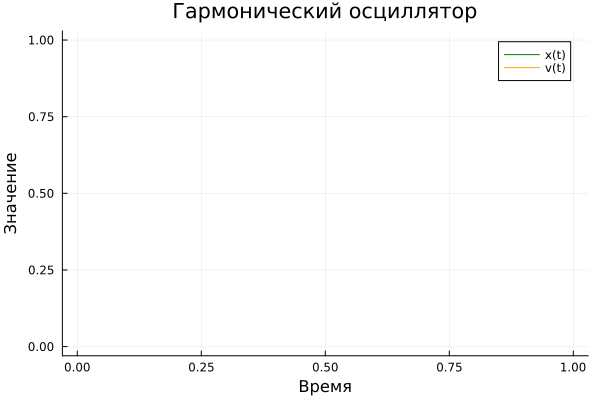

In [33]:
anim = @animate for i in 1:length(R1)
    plot(sol.t[1:i], R1[1:i], title="Гармонический осциллятор", xaxis="Время",yaxis="Значение",label="x(t)", c=:green, leg=:topright)
    plot!(sol.t[1:i], R2[1:i], label="v(t)", c=:orange, leg=:topright)
end
gif(anim, "presentation//image//8.gif")

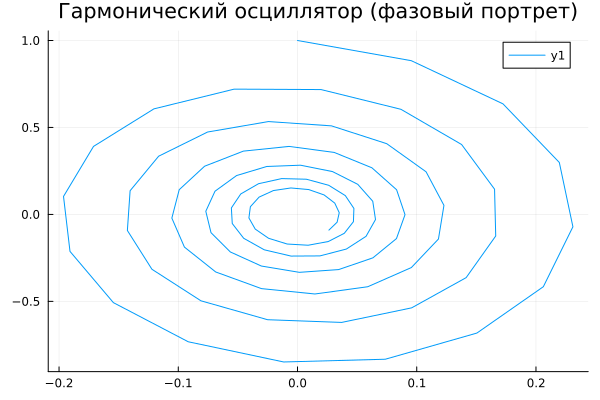

In [32]:
plot(R1, R2, title="Гармонический осциллятор (фазовый портрет)", leg=:topright)